# Evaluate SAM

In this notebook we try different post-processing for the masks given by SAM

## Initialization

In [1]:
import matplotlib.pyplot as plt
import sys
sys.path.append("..")
from utils.utilsSAM import *
from models.SAM import SAMSegmenter
from models.alphaClip import AlphaClip


from datasets.dataset_vars import (
        COCO_CATEGORIES, 
        ADE20K_SEM_SEG_FULL_CATEGORIES as ADE20K_CATEGORIES
)

PATH_WEIGHT_SAM = '../checkpoints/sam_vit_h_4b8939.pth'
PATH_WEIGHT_ACLIP = '../checkpoints/clip_b16_grit+mim_fultune_4xe.pth'


In [2]:
image = cv2.imread('../datasets/ADE20K_2021_17_01/images/ADE/training/cultural/apse__indoor/ADE_train_00001472.jpg')
    
segmenter = SAMSegmenter(model_type='vit_h', weight_path = PATH_WEIGHT_SAM)

classifier = AlphaClip(model_type='ViT-B/16', weight_path = PATH_WEIGHT_ACLIP)

Loading weight for SAM


/home/disi/miniconda3/lib/python3.10/site-packages/segment_anything/build_sam.py:105: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(f)
/home/disi/VF-

## Try one image

Try one image with one method

In [3]:
# Segment Image
masks = segmenter.predict_mask(image)

#Post Processing
# blurred_masks - red_circle_masks - bbox_masks - black_background_masks - nothing
images, masks_post = post_processing(masks, image, post_processing='none')
vocabulary = take_vocabulary(dataset = COCO_CATEGORIES)

# Classify Mask
logits = classifier.classify_mask(images, masks_post, vocabulary, flagUseAlpha = True)


predictions = logits.argmax(dim=-1)
values, indices = logits.cpu().topk(1)
# for dim in range(len(values)):
#     print("\n\nTop 5 predictions for mask ", dim)
#     for value, index in zip(values[dim], indices[dim]):
#         print(f"\t{vocabulary[index]}: {value.item()}")


Generated 58 masks


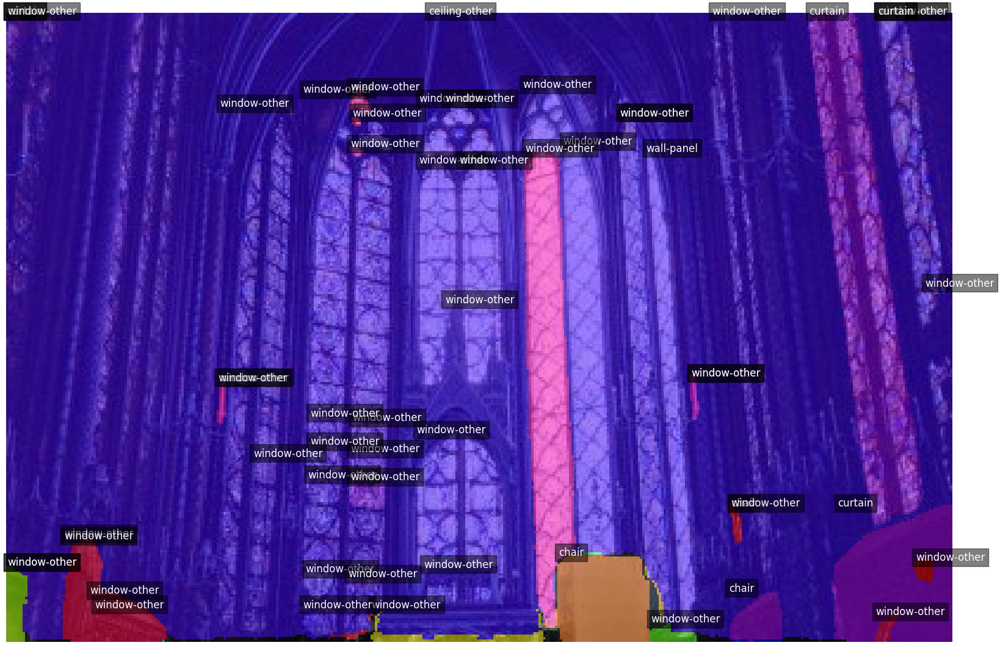

In [4]:
overlay_image = recompose_image(image, masks)
# Plot the overlay image with the top 1 prediction labels
plt.figure(figsize=(20, 20))
plt.imshow(overlay_image)
for i, mask in enumerate(masks):
    x, y, w, h = mask['bbox']
    plt.text(x, y, vocabulary[predictions[i]], color='white', fontsize=12, bbox=dict(facecolor='black', alpha=0.5))
plt.axis('off')
plt.show()

## Try multiple images

Try multiple images with all post-processing methods

In [5]:
path_files = '../datasets/subsetADE.txt'

path_images = read_line_file(path_files)

methods = ["blurred_masks", "red_circle_masks", "black_background_masks", "bbox_masks",]
vocabulary = take_vocabulary(dataset = COCO_CATEGORIES)

results = segment_and_classify(segmenter, classifier, path_images, vocabulary, methods)

Processing image ../datasets/ADE20K_2021_17_01/images/ADE/validation/cultural/art_studio/ADE_val_00000037.jpg
Generated 83 masks
Processing image ../datasets/ADE20K_2021_17_01/images/ADE/validation/cultural/apse__indoor/ADE_val_00000025.jpg


Generated 98 masks
Processing image ../datasets/ADE20K_2021_17_01/images/ADE/validation/home_or_hotel/bathroom/ADE_val_00000085.jpg
Generated 41 masks
Processing image ../datasets/ADE20K_2021_17_01/images/ADE/validation/industrial/oil_refinery__outdoor/ADE_val_00001650.jpg
Generated 22 masks
Processing image ../datasets/ADE20K_2021_17_01/images/ADE/validation/nature_landscape/fjord/ADE_val_00001355.jpg
Generated 74 masks
Processing image ../datasets/ADE20K_2021_17_01/images/ADE/validation/shopping_and_dining/drugstore/ADE_val_00000336.jpg
Generated 211 masks
Processing image ../datasets/ADE20K_2021_17_01/images/ADE/validation/sports_and_leisure/boxing_ring/ADE_val_00000198.jpg
Generated 56 masks
Processing image ../datasets/ADE20K_2021_17_01/images/ADE/validation/transportation/hallway/ADE_val_00001397.jpg
Generated 18 masks
Processing image ../datasets/ADE20K_2021_17_01/images/ADE/validation/unclassified/outliers__flood_plain/ADE_val_00000985.jpg
Generated 21 masks
Processing image ..

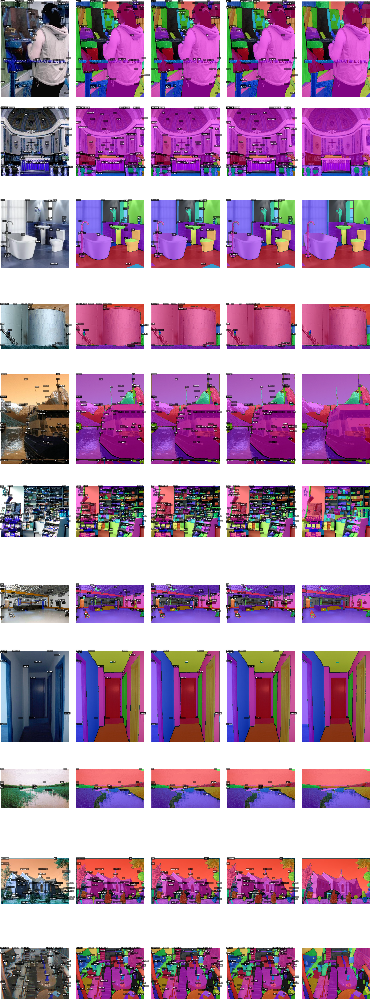

In [6]:
#!! DA SISTEMARE

import math
num_cols = 5  # Numero di immagini per riga
num_images = len(results['images'])
methods = list(results['logits'][0].keys())
num_rows = math.ceil(num_images * (len(methods) + 1) / num_cols)

# Creazione della figura
fig, axes = plt.subplots(num_rows, num_cols, figsize=(40, 10 * num_rows))

counter = 0

for image, seg, logit in zip(results['images'], results['segmentations'], results['logits']):
    
    overlay_image = recompose_image(image, seg)
    
    # Mostra immagine originale
    if counter < len(axes.flatten()):
        ax = axes.flatten()[counter]
        ax.imshow(image)
        ax.axis('off')
        counter += 1

    # Mostra logit per ogni metodo
    for method in logit.keys():
        predictions = logit[method].argmax(dim=-1)
        for i, mask in enumerate(seg):
            x, y, w, h = mask['bbox']
            ax.text(x, y, vocabulary[predictions[i]], color='white', fontsize=8,
                    bbox=dict(facecolor='black', alpha=0.5))
        # annotated_overlay = annotate_predictions_on_image(overlay_image, seg, logit[method], vocabulary)

        if counter < len(axes.flatten()):
            ax = axes.flatten()[counter]
            ax.imshow(overlay_image)
            ax.axis('off')
            counter += 1

# Layout ordinato
plt.tight_layout()
plt.show()